# Image Retrieval using locality sensitive hashing
### (Bonus : Adversarial Attack)
Harsh Shah(200050049); Maulinraj Parmar(200050098); Radhika Chouhan(200050114); Rounak Dalmia(200050119)



In [ ]:
# installing necessary modules
!pip install lshashpy3
!pip install pretrainedmodels
!pip install imutils

%reload_ext autoreload
%autoreload 2
%matplotlib inline

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for lshashpy3: filename=lshashpy3-0.0.8-py3-none-any.whl size=8903 sha256=09ecf54385a269449f5009042496a5d7c5f3f393edb46c100dd0931def42388e
  Stored in directory: /root/.cache/pip/wheels/32/9b/ae/27f94ba2cd85b1cd5af645fa78f90b703c9e1fb9e2b55a04e0
Successfully built lshashpy3
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 58 kB 6.8 MB/s 
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60966 sha256=91eae476ec846156d6207b1eb44a0e747e039c78c0a95d1a7b5856b7143ac147
  Stored in directory: /root/.cache/pip/wheels/ed/27/e8/9543d42de2740d3544db96aefef63bda3f2c1761b3334f4873
Successfully built pretrainedmodels
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install git+https://github.com/openai/CLIP.git

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-jj8201bi
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-jj8201bi
  Resolved https://github.com/openai/CLIP.git to commit a9b1bf5920416aaeaec965c25dd9e8f98c864f16
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 KB 2.2 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369398 sha256=1d380c21221581ed5992216d36674fce79856234406bebe1b5cd9a2c7700e100
  Stored in directory: /tmp/pip-ephem-wheel-cache-lqu1puhl/wheels/c8/e4/e1/11374c111387672fc2068dfbe0d4b424cb9cdd1b2e184a71b5
Successfully built clip
  Attempting uninstall: clip
    Found existing installation: clip 0.2.0
    Uninstalling clip-0.2.0:
      Successfully uninstalled clip-0.2.0


In [ ]:
import clip
clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [ ]:
# mounting drive(not required on running locally)
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# (not required if runninng locally)
%cd drive/MyDrive/Reverse_Image_Search_LSH

/content/drive/MyDrive/Reverse_Image_Search_LSH


In [ ]:
# imports
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision.transforms import transforms
from torch.utils.data import DataLoader, Dataset

import numpy as np
import pandas as pd

import os
import sys
import time
import random
import pickle

import matplotlib.pyplot as plt
import matplotlib

import joblib
import cv2

import pretrainedmodels
from lshashpy3 import LSHash
from PIL import Image
import torchvision.transforms as T

from concurrent.futures import ThreadPoolExecutor
from concurrent.futures import as_completed

from tqdm import tqdm_notebook, tqdm

from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier

from imutils import paths

from torch.utils.tensorboard import SummaryWriter

import tensorflow as tf
import tensorboard as tb
tf.io.gfile = tb.compat.tensorflow_stub.io.gfile

writer = SummaryWriter(f"log_dir/caltech_resnet34_512")
%load_ext tensorboard

In [ ]:
def seed_everything(SEED=42):
    random.seed(SEED)
    np.random.seed(SEED)
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    torch.cuda.manual_seed_all(SEED)
    torch.backends.cudnn.benchmark = True

In [ ]:
if torch.cuda.is_available():
    device = 'cuda'
else:
    device = 'cpu'

seed_everything(SEED=73)

In [ ]:
# Hyperparameters
NUM_EPOCHS = 5
BATCH_SIZE = 32
LR = 1e-5

In [ ]:
# generating datasets
image_paths = list(paths.list_images('data/caltech-101/101_ObjectCategories'))
image_names = []
labels = []

for image_path in image_paths:
    label = image_path.split(os.path.sep)[-2]
    if label == 'BACKGROUND_Google':
        continue
    image_names.append(image_path)
    labels.append(label)
labels = np.array(labels)

In [ ]:
# one hot encode
lb = LabelBinarizer()
labels = lb.fit_transform(labels)
print(f"Total number of classes: {len(lb.classes_)}")

Total number of classes: 101


In [ ]:
query = np.zeros(shape=(2, 101))
query[0, 72] = 1
query[1, 45] = 1
lb.inverse_transform(query)

array(['pizza', 'gramophone'], dtype='<U15')

In [ ]:
# tranforms
train_transform = transforms.Compose(
    [transforms.ToPILImage(),
     transforms.Resize((224, 224)),
     transforms.ToTensor(),
     transforms.Normalize(mean=[0.485, 0.456, 0.406],
                          std=[0.229, 0.224, 0.225])])

val_transform = transforms.Compose(
    [transforms.ToPILImage(),
     transforms.Resize((224, 224)),
     transforms.ToTensor(),
     transforms.Normalize(mean=[0.485, 0.456, 0.406],
                          std=[0.229, 0.224, 0.225])])


In [ ]:
# custom dataset
class CaltechDataset(Dataset):
    def __init__(self, image_names, labels=None, transforms=None):
        self.image_names = image_names
        self.y = labels
        self.transforms = transforms

    def __len__(self):
        return (len(self.image_names))

    def __getitem__(self, i):
        data = cv2.imread(self.image_names[i])
        data = cv2.cvtColor(data, cv2.COLOR_BGR2RGB)

        if self.transforms:
            data = self.transforms(data)

        if self.y is not None:
            return (data, self.y[i])
        else:
            return data

train_ratio, val_ratio = 0.8, 0.1
test_ratio = 1 - train_ratio - val_ratio

dataset = CaltechDataset(image_names, labels, train_transform)

train_samples = int(dataset.__len__()*train_ratio)
val_samples = int(dataset.__len__()*val_ratio)
test_samples = dataset.__len__() - train_samples - val_samples

train_data, val_data, test_data = torch.utils.data.random_split(dataset,
                                                              [train_samples, val_samples, test_samples])
train_images = []


In [ ]:
# dataloaders
trainloader = DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)
valloader = DataLoader(val_data, batch_size=BATCH_SIZE, shuffle=True)
testloader = DataLoader(test_data, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
# models
# the resnet34 model
class ResNet34(nn.Module):
    def __init__(self, pretrained):
        super(ResNet34, self).__init__()
        if pretrained is True:
            self.model = pretrainedmodels.__dict__['resnet34'](pretrained='imagenet')
        else:
            self.model = pretrainedmodels.__dict__['resnet34'](pretrained=None)

        # change the classification layer
        self.l0 = nn.Linear(512, len(lb.classes_))
        self.dropout = nn.Dropout(0.4)

    def forward(self, x):
        # get the batch size only, ignore (c, h, w)
        batch, _, _, _ = x.shape
        x = self.model.features(x)
        x = F.adaptive_avg_pool2d(x, 1).reshape(batch, -1)
        x = self.dropout(x)
        l0 = self.l0(x)
        return l0

    def embed(self, x):
        batch, _, _, _ = x.shape
        x = self.model.features(x)
        x = F.adaptive_avg_pool2d(x, 1).reshape(batch, -1)

        return x

In [ ]:
# training function
def fit(model, dataloader):
    print('Training')
    model.train()
    running_loss = 0.0
    running_correct = 0
    for i, data in tqdm(enumerate(dataloader), total=len(dataloader)):
        data, target = data[0].to(device), data[1].to(device)
        train_images.append(data[0])
        optimizer.zero_grad()
        outputs = model(data)
        loss = criterion(outputs, torch.max(target, 1)[1])
        running_loss += loss.item()
        _, preds = torch.max(outputs.data, 1)
        running_correct += (preds == torch.max(target, 1)[1]).sum().item()
        loss.backward()
        optimizer.step()

    loss = running_loss/len(dataloader.dataset)
    accuracy = 100. * running_correct/len(dataloader.dataset)

    print(f"Train Loss: {loss:.4f}, Train Acc: {accuracy:.2f}")

    return loss, accuracy

# validation function
def validate(model, dataloader):
    print('Validating')
    model.eval()
    running_loss = 0.0
    running_correct = 0
    with torch.no_grad():
        for i, data in tqdm(enumerate(dataloader), total=len(dataloader)):
            data, target = data[0].to(device), data[1].to(device)
            outputs = model(data)
            loss = criterion(outputs, torch.max(target, 1)[1])
            running_loss += loss.item()
            _, preds = torch.max(outputs.data, 1)
            running_correct += (preds == torch.max(target, 1)[1]).sum().item()

        loss = running_loss/len(dataloader.dataset)
        accuracy = 100. * running_correct/len(dataloader.dataset)
        print(f'Val Loss: {loss:.4f}, Val Acc: {accuracy:.2f}')

        return loss, accuracy

# embedding plottinng
def feature_extraction(model, dataloader, max_images=500, plot_embedding=True):
    if plot_embedding:
        print('Plotting embedding')
    model.eval()
    features = []
    class_labels = []
    image_data = []
    num_images = 0
    with torch.no_grad():
        for i, data in tqdm(enumerate(dataloader), total=len(dataloader)):
            data, target = data[0].to(device), data[1].to(device)
            num_images += data.shape[0]

            if num_images > max_images:
                break

            outputs = model.embed(data)
            features.append(outputs)
            class_labels.append(torch.max(target, 1)[1])

            if plot_embedding:
              image_data.append(data)

        class_labels = torch.concat(class_labels, dim=0)
        features = torch.concat(features, dim=0)

        if plot_embedding:
          image_data = torch.concat(image_data, dim=0)
          writer.add_embedding(features, metadata=class_labels, global_step=0, label_img=image_data)

    return features, class_labels

# testing
def test(model, dataloader):
    correct = 0
    total = 0
    with torch.no_grad():
        for data in testloader:
            inputs, target = data[0].to(device), data[1].to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += target.size(0)
            correct += (predicted == torch.max(target, 1)[1]).sum().item()
    return correct, total


In [ ]:
# model
model = ResNet34(pretrained=True).to(device)

# optimizer
optimizer = optim.Adam(model.parameters(), lr=LR)

# loss function
criterion = nn.CrossEntropyLoss()

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

In [ ]:
# load saved model
PATH = f"outputs/saved_models/resnet34_epochs{NUM_EPOCHS}.pth"
model.load_state_dict(torch.load(PATH, map_location=torch.device(device)))

<All keys matched successfully>

In [ ]:
# training
train_loss , train_accuracy = [], []
val_loss , val_accuracy = [], []
print(f"Training on {len(train_data)} examples, validating on {len(val_data)} examples...")
start = time.time()
for epoch in range(NUM_EPOCHS):
    epoch_time = time.time()
    print(f"Epoch {epoch+1} of {NUM_EPOCHS}")

    train_epoch_loss, train_epoch_accuracy = fit(model, trainloader)
    val_epoch_loss, val_epoch_accuracy = validate(model, valloader)
    train_loss.append(train_epoch_loss)
    train_accuracy.append(train_epoch_accuracy)
    val_loss.append(val_epoch_loss)
    val_accuracy.append(val_epoch_accuracy)

    print(f"Time : {time.time()-epoch_time}")

torch.save(model.state_dict(), f"outputs/saved_models/resnet34_epochs{NUM_EPOCHS}.pth")
end = time.time()
print((end-start)/60, 'minutes')

Training on 6941 examples, validating on 867 examples...
Epoch 1 of 5
Training


  0%|          | 1/217 [00:41<2:28:44, 41.32s/it]


KeyboardInterrupt: ignored

In [ ]:
# saving trained model
torch.save(model.state_dict(), f"outputs/saved_models/resnet34_epochs{NUM_EPOCHS}.pth")

In [ ]:
# plotting
plt.figure(figsize=(10, 7))
plt.plot(train_accuracy, color='green', label='train accuracy')
plt.plot(val_accuracy, color='blue', label='validataion accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.savefig('outputs/plots/accuracy.png')

# loss plots
plt.figure(figsize=(10, 7))
plt.plot(train_loss, color='orange', label='train loss')
plt.plot(val_loss, color='red', label='validataion loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('outputs/plots/loss.png')

In [ ]:
# saving losses
# save the accuracy and loss lists as pickled files
print('Pickling accuracy and loss lists...')
joblib.dump(train_accuracy, 'outputs/saved_models/train_accuracy.pkl')
joblib.dump(train_loss, 'outputs/saved_models/train_loss.pkl')
joblib.dump(val_accuracy, 'outputs/saved_models/val_accuracy.pkl')
joblib.dump(val_loss, 'outputs/saved_models/val_loss.pkl')

In [ ]:
# testing
correct, total = test(model, testloader)
print('Accuracy of the network on test images: %0.3f %%' % (100 * correct / total))

In [ ]:
# feature extraction and visualization
features, labels = feature_extraction(model, trainloader, max_images=500)

In [ ]:
# embedding visualization(using tensorboard)

%tensorboard --logdir log_dir

Reusing TensorBoard on port 6006 (pid 3277), started 0:06:31 ago. (Use '!kill 3277' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# load features
features, labels = joblib.load("outputs/embeddings/features.pt")

In [ ]:
train_features, train_labels = feature_extraction(model, trainloader, max_images=10000, plot_embedding=False)

joblib.dump((train_features, train_labels), 'outputs/embeddings/features.pt')

test_features, test_labels = feature_extraction(model, testloader, max_images=1000, plot_embedding=False)
joblib.dump((test_features, test_labels), 'outputs/embeddings/test_features.pt')


Plotting embedding


100%|██████████| 217/217 [42:21<00:00, 11.71s/it]


Plotting embedding


100%|██████████| 28/28 [05:06<00:00, 10.93s/it]


In [ ]:
train_features, train_labels = joblib.load('outputs/embeddings/features.pt')
test_features, test_labels = joblib.load('outputs/embeddings/test_features.pt')

In [ ]:
test_features, test_labels = feature_extraction(model, testloader, max_images=1000, plot_embedding=False)

NameError: ignored

In [ ]:
# KNN
start_time = time.time()

neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(train_features.cpu(), train_labels.cpu())
k_neighbours = neigh.kneighbors(X=test_features.cpu(), n_neighbors=3, return_distance=True)

print(time.time() - start_time)

0.30257081985473633


In [ ]:
# train
classes = []
for idx, row in enumerate(k_neighbours[1]):
  tmp_row = []
  tmp_row.append(test_labels[idx])
  for elem in row:
    tmp_row.append(train_labels[elem].item())
  classes.append(tmp_row)

print(classes)

[[4998 4280 5310]
 [4554 4245 6220]
 [2568 1565 6645]
 ...
 [4530 3437 4370]
 [6373 3226 2961]
 [6223 5271  128]]
[[tensor(54), 54, 54, 54], [tensor(94), 94, 94, 94], [tensor(29), 29, 29, 29], [tensor(12), 12, 12, 12], [tensor(47), 47, 47, 47], [tensor(0), 1, 0, 0], [tensor(3), 3, 3, 3], [tensor(32), 32, 32, 32], [tensor(45), 45, 45, 45], [tensor(86), 86, 86, 86], [tensor(60), 60, 60, 95], [tensor(4), 4, 4, 4], [tensor(68), 68, 68, 68], [tensor(75), 75, 75, 75], [tensor(68), 68, 68, 68], [tensor(94), 94, 94, 94], [tensor(58), 58, 58, 58], [tensor(47), 47, 47, 47], [tensor(47), 47, 47, 47], [tensor(18), 18, 18, 18], [tensor(3), 3, 3, 3], [tensor(1), 1, 1, 1], [tensor(79), 79, 79, 79], [tensor(41), 41, 41, 41], [tensor(1), 1, 1, 1], [tensor(15), 15, 15, 15], [tensor(23), 23, 23, 23], [tensor(10), 10, 10, 10], [tensor(46), 46, 46, 46], [tensor(99), 99, 99, 99], [tensor(94), 94, 94, 94], [tensor(51), 51, 51, 51], [tensor(1), 1, 1, 1], [tensor(66), 66, 66, 66], [tensor(34), 34, 34, 34], [te

1

In [ ]:
# Locality senitive hashing
k = 10 # hash size
L = 5  # number of tables
d = 512 # Dimension of Feature vector
lsh = LSHash(hash_size=k, input_dim=d, num_hashtables=L)




In [ ]:
for i in tqdm_notebook(range(train_features.shape[0])):
    lsh.index(train_features[i].tolist(), extra_data=train_labels[i].tolist())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """Entry point for launching an IPython kernel.


  0%|          | 0/6941 [00:00<?, ?it/s]

In [ ]:
# multi-threading
top_n = 3
test_features_lst = test_features.tolist()

to_PIL = T.ToPILImage()
inv_transform = transforms.Compose([transforms.Normalize(mean=[-0.485/0.299, -0.456/0.224, -0.406/0.225],
                                                          std=[1/0.229, 1/0.224, 1/0.225])])
# sample_batch = next(iter(testloader))

sample_batch = lsh.query(test_features_lst[0], num_results=top_n, distance_func="euclidean")

img_b = inv_transform(train_images[(train_features == sample_batch[0][0][0]).nonzero(as_tuple=True)[0]])
img_b[img_b>1.0] = 1.0
img_b[img_b<0.0] = 0.0
img_b_tensor = img_b
img_b = to_PIL(img_b)
display(img_b)

# img_b = inv_transform(sample_batch[0][8])
# img_b[img_b>1.0] = 1.0
# img_b[img_b<0.0] = 0.0
# img_b_tensor = img_b
# img_b = to_PIL(img_b)
# display(img_b)

# results = [None]*len(test_features_lst)

# def query_image(j):
#    results[j] = lsh.query(test_features_lst[j], num_results=top_n, distance_func="euclidean")

# start_time = time.time()
# with ThreadPoolExecutor(max_workers = 32) as executor:
#     executor.map(query_image, range(len(test_features_lst)))
# print(time.time() - start_time)


NameError: ignored

In [ ]:
# comparison
NUM_SAMPLES = 100
K_NN = 50

test_features = test_features.cpu()
train_features = train_features.cpu()
train_labels = train_labels.cpu()

test_features_lst = test_features.tolist()

dataset_size = list(range(500, len(train_features), 500))


n = 30000
test_features_rand = np.random.randn(1000, 512)
train_features_rand = np.random.randn(n, 512)
train_labels_rand = np.random.randint(low=0, high=101, size=n)

test_features_lst_rand = test_features_rand.tolist()

dataset_size_rand = list(range(500, len(train_features_rand), 500))

print(train_features.shape)



(30000, 512)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:22: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


  0%|          | 0/30000 [00:00<?, ?it/s]

In [ ]:
# actual dataset
for i in tqdm_notebook(range(train_features.shape[0])):
    lsh.index(train_features[i].tolist(), extra_data=train_labels[i].tolist())

KNN_times = []
LSH_times = []

for sz in dataset_size:
    print(f"Dataset size : {sz}")

    ## KNN
    neigh = KNeighborsClassifier(n_neighbors=3)
    neigh.fit(train_features[:sz], train_labels[:sz])
    samples = np.random.randint(low=0, high=test_features.shape[0], size=NUM_SAMPLES)


    total_time = 0
    for i in range(NUM_SAMPLES):
        x_sample = test_features[samples[i]][None, :]
        start_time = time.time()
        k_neighbours = neigh.kneighbors(X=x_sample, n_neighbors=K_NN, return_distance=True)
        total_time += time.time() - start_time
    t = total_time/NUM_SAMPLES
    print(f"Average time for KNN : {t}")
    KNN_times.append(t)


    total_time = 0
    for i in range(NUM_SAMPLES):
        x_sample = test_features_lst[samples[i]]
        start_time = time.time()
        lsh.query(x_sample, num_results=K_NN, distance_func="euclidean")
        total_time += time.time() - start_time

    t = total_time/NUM_SAMPLES
    print(f"Average time for LSH : {t}")
    LSH_times.append(t)

Dataset size : 500
Average time for KNN : 0.0011802220344543457
Average time for LSH : 0.032854948043823246
Dataset size : 1000
Average time for KNN : 0.0018351531028747558
Average time for LSH : 0.0318081545829773
Dataset size : 1500
Average time for KNN : 0.0028414440155029295
Average time for LSH : 0.032078449726104734
Dataset size : 2000
Average time for KNN : 0.0035341930389404296
Average time for LSH : 0.03126391649246216
Dataset size : 2500
Average time for KNN : 0.0042097377777099605
Average time for LSH : 0.0328174090385437
Dataset size : 3000
Average time for KNN : 0.004561724662780761
Average time for LSH : 0.03177865743637085
Dataset size : 3500
Average time for KNN : 0.005604586601257324
Average time for LSH : 0.04041451454162598
Dataset size : 4000
Average time for KNN : 0.006627826690673828
Average time for LSH : 0.03515838384628296
Dataset size : 4500
Average time for KNN : 0.008939354419708253
Average time for LSH : 0.03115856409072876
Dataset size : 5000
Average time 

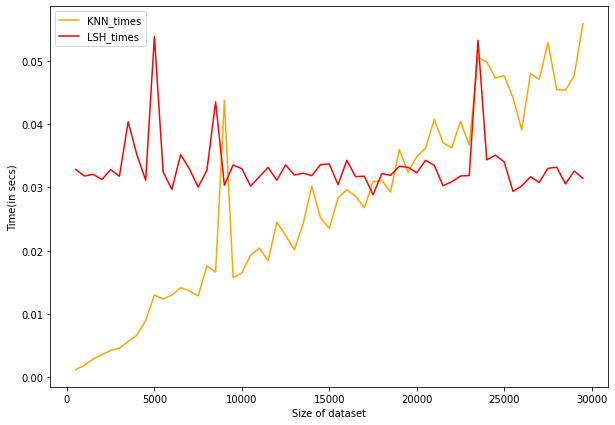

In [ ]:
## plotting times

plt.figure(figsize=(10, 7))
plt.plot(dataset_size, KNN_times, color='orange', label='KNN_times')
plt.plot(dataset_size, LSH_times, color='red', label='LSH_times')
plt.xlabel('Size of dataset')
plt.ylabel('Time(in secs)')
plt.legend()
plt.savefig('outputs/plots/time_comparison_random.png')

In [ ]:
# actual dataset
for i in tqdm_notebook(range(train_features_rand.shape[0])):
    lsh.index(train_features_rand[i].tolist(), extra_data=train_labels_rand[i].tolist())

KNN_times = []
LSH_times = []

for sz in dataset_size_rand:
    print(f"Dataset size : {sz}")

    ## KNN
    neigh = KNeighborsClassifier(n_neighbors=3)
    neigh.fit(train_features[:sz], train_labels[:sz])
    samples = np.random.randint(low=0, high=test_features_rand.shape[0], size=NUM_SAMPLES)


    total_time = 0
    for i in range(NUM_SAMPLES):
        x_sample = test_features_rand[samples[i]][None, :]
        start_time = time.time()
        k_neighbours = neigh.kneighbors(X=x_sample, n_neighbors=K_NN, return_distance=True)
        total_time += time.time() - start_time
    t = total_time/NUM_SAMPLES
    print(f"Average time for KNN : {t}")
    KNN_times.append(t)


    total_time = 0
    for i in range(NUM_SAMPLES):
        x_sample = test_features_lst_rand[samples[i]]
        start_time = time.time()
        lsh.query(x_sample, num_results=K_NN, distance_func="euclidean")
        total_time += time.time() - start_time

    t = total_time/NUM_SAMPLES
    print(f"Average time for LSH : {t}")
    LSH_times.append(t)

In [ ]:
## plotting times

plt.figure(figsize=(10, 7))
plt.plot(dataset_size, KNN_times, color='orange', label='KNN_times')
plt.plot(dataset_size, LSH_times, color='red', label='LSH_times')
plt.xlabel('Size of dataset')
plt.ylabel('Time(in secs)')
plt.legend()
plt.savefig('outputs/plots/time_comparison_random.png')

# Adversarial attack using Fast Gradient Method

In [ ]:
!pip install adversarial-robustness-toolbox

In [ ]:
# imports for adversarial attack
from art.attacks.evasion import FastGradientMethod
from art.estimators.classification import PyTorchClassifier

In [ ]:
# Generate adversarial test examples
classifier = PyTorchClassifier(
    model=model,
    clip_values=(0, 1),
    loss=criterion,
    optimizer=optimizer,
    input_shape=(BATCH_SIZE, 224, 224),
    nb_classes=101,
)

attack = FastGradientMethod(estimator=classifier, eps=0.1)

sample_batch = next(iter(testloader))
sample_images_numpy = sample_batch[0].cpu().numpy()
x_test_adv = attack.generate(x=sample_batch[0].cpu().numpy())

In [ ]:
# Evaluate the ART classifier on adversarial test examples
predictions = model(torch.from_numpy(x_test_adv).to(device))
accuracy = (torch.argmax(predictions, dim=1) == torch.max(sample_batch[1].to(device), 1)[1]).sum().item() / len(sample_batch[1])
print("Accuracy on adversarial test examples: {}%".format(accuracy * 100))
print(torch.argmax(predictions, dim=1) == torch.max(sample_batch[1].to(device), 1)[1])
print(torch.argmax(predictions, dim=1))
print(torch.max(sample_batch[1].to(device), 1)[1])

Accuracy on adversarial test examples: 81.25%
tensor([ True,  True, False,  True,  True,  True,  True,  True, False,  True,
        False,  True,  True,  True, False,  True,  True,  True,  True, False,
         True,  True,  True,  True,  True,  True,  True, False,  True,  True,
         True,  True], device='cuda:0')
tensor([54, 94, 47, 12, 47,  0,  3, 32, 72, 86, 95,  4, 68, 75, 36, 94, 58, 47,
        47, 35,  3,  1, 79, 41,  1, 15, 23, 36, 46, 99, 94, 51],
       device='cuda:0')
tensor([54, 94, 29, 12, 47,  0,  3, 32, 45, 86, 60,  4, 68, 75, 68, 94, 58, 47,
        47, 18,  3,  1, 79, 41,  1, 15, 23, 10, 46, 99, 94, 51],
       device='cuda:0')


In [ ]:
predictions = model(sample_batch[0].to(device))
accuracy = (torch.argmax(predictions, dim=1) == torch.max(sample_batch[1].to(device), 1)[1]).sum().item() / len(sample_batch[1])
print("Accuracy on adversarial test examples: {}%".format(accuracy * 100))

Accuracy on adversarial test examples: 100.0%


In [ ]:
from PIL import Image
import torchvision.transforms as T

In [ ]:
to_PIL = T.ToPILImage()
inv_transform = transforms.Compose([transforms.Normalize(mean=[-0.485/0.299, -0.456/0.224, -0.406/0.225],
                                                          std=[1/0.229, 1/0.224, 1/0.225])])


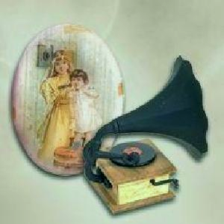

In [ ]:
# Benign gramophone
img_b = inv_transform(sample_batch[0][8])
img_b[img_b>1.0] = 1.0
img_b[img_b<0.0] = 0.0
img_b_tensor = img_b
img_b = to_PIL(img_b)
display(img_b)

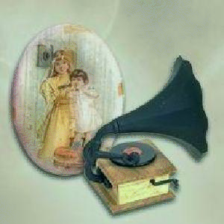

In [ ]:
# Perturbed Gramophone(to pizza)
img_p = inv_transform(torch.from_numpy(x_test_adv)[8])
img_p[img_p>1.0] = 1.0
img_p[img_p<0.0] = 0.0
img_p_tensor = img_p
img_p = to_PIL(img_p)
display(img_p)